<a href="https://colab.research.google.com/github/AviralTripathim22ma012/Generative-Adversarial-Networks-implementation/blob/main/DC-GAN-%26-Style-GAN-2-and-3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**REFERENCES**

In [ ]:
'''
REFEREMCES:

for QUESTION 1:

https://www.youtube.com/watch?v=QE-AfZLVX2w
https://mafda.medium.com/gans-deep-convolutional-gans-with-mnist-part-3-8bad9a96ff65
https://stackoverflow.com/questions/68243122/runtimeerror-given-groups-1-weight-of-size-64-32-3-3-expected-input128
https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
https://github.com/mafda/generative_adversarial_networks_101/blob/master/src/mnist/01_GAN_MNIST.ipynb
https://github.com/coreprinciple6/GAN-Study/tree/master/DCGAN
https://github.com/AKASHKADEL/dcgan-mnist/tree/master/


for QUESTION 2:

@inproceedings{Karras2021,
  author = {Tero Karras and Miika Aittala and Samuli Laine and Erik H\"ark\"onen and Janne Hellsten and Jaakko Lehtinen and Timo Aila},
  title = {Alias-Free Generative Adversarial Networks},
  booktitle = {Proc. NeurIPS},
  year = {2021}
}


@inproceedings{Karras2020ada,
  title     = {Training Generative Adversarial Networks with Limited Data},
  author    = {Tero Karras and Miika Aittala and Janne Hellsten and Samuli Laine and Jaakko Lehtinen and Timo Aila},
  booktitle = {Proc. NeurIPS},
  year      = {2020}
}


https://github.com/jeffheaton/stylegan2-toys/tree/main
https://github.com/jeffheaton/stylegan2-toys/blob/main/morph_video_real.ipynb
https://github.com/justinpinkney/stylegan-matlab-playground/blob/master/examples/interpolation.md
https://github.com/jeffheaton/t81_558_deep_learning/blob/master/t81_558_class_07_1_gan_intro.ipynb
https://blog.paperspace.com/how-to-set-up-stylegan2-ada-pytorch-on-paperspace/
https://github.com/NVlabs/stylegan2-ada-pytorch#pretrained-networks
https://discuss.pystorch.org/t/running-a-pre-trained-tensorflow-stylegan-model-in-pytorch/42001
https://github.com/lernapparat/lernapparat/blob/master/style_gan/pytorch_style_gan.ipynb


ADDITIONAL RESOURCES USED:

perplexity.ai
chat.openai.com
bing.com

'''



---



---



**QUESTION 1: TRAINING A DCGAN**



---



---



In [ ]:
import torch
from torchvision import datasets, transforms
import torchvision.utils as vutils

# Define the transformations to be applied to the dataset
transform = transforms.Compose([
    transforms.ToTensor(), # convert image to tensor
    transforms.Normalize((0.1307,), (0.3081,)) # normalize the image with mean and std
])

# Load the XMNIST dataset
train_dataset = datasets.EMNIST(root='./data', train=True, download=True, transform=transform, split= 'balanced')
test_dataset = datasets.EMNIST(root='./data', train=False, download=True, transform=transform, split= 'balanced')

# Create data loaders for the dataset
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=128, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=128, shuffle=False)


100%|██████████| 561753746/561753746 [00:17<00:00, 31273044.78it/s]


Extracting ./data/EMNIST/raw/gzip.zip to ./data/EMNIST/raw


In [ ]:
print(type(test_loader))

<class 'torch.utils.data.dataloader.DataLoader'>


In [ ]:
import torch.nn as nn
import torch.nn.functional as F

class Generator(nn.Module):
    def __init__(self, nc, nz, ngf):
      super(Generator, self).__init__()
      self.network = nn.Sequential(
          nn.ConvTranspose2d(nz, ngf*4, 4, 1, 0, bias=False),
          nn.BatchNorm2d(ngf*4),
          nn.ReLU(True),

          nn.ConvTranspose2d(ngf*4, ngf*2, 3, 2, 1, bias=False),
          nn.BatchNorm2d(ngf*2),
          nn.ReLU(True),

          nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
          nn.BatchNorm2d(ngf),
          nn.ReLU(True),

          nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
          nn.Tanh()
      )

    def forward(self, input):
      output = self.network(input)
      return output

In [ ]:
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models


class Discriminator(nn.Module):
    def __init__(self, nc, ndf):
        super(Discriminator, self).__init__()
        self.network = nn.Sequential(

                nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
                nn.LeakyReLU(0.2, inplace=True),

                nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
                nn.BatchNorm2d(ndf * 2),
                nn.LeakyReLU(0.2, inplace=True),

                nn.Conv2d(ndf * 2, ndf * 4, 3, 2, 1, bias=False),
                nn.BatchNorm2d(ndf * 4),
                nn.LeakyReLU(0.2, inplace=True),

                nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),
                nn.Sigmoid()
            )
    def forward(self, input):
        output = self.network(input)
        return output.view(-1, 1).squeeze(1)

# generator = Generator(nc, nz, ngf)
# discriminator = Discriminator(nc, ndf)


In [ ]:
import torch
import matplotlib.pyplot as plt
from torchvision import datasets, transforms
import math
import itertools
import imageio
import natsort
from glob import glob

In [ ]:
def generate_images(epoch, path, fixed_noise, num_test_samples, netG, device, use_fixed=False):
    z = torch.randn(num_test_samples, 100, 1, 1, device=device)
    size_figure_grid = int(math.sqrt(num_test_samples))
    title = None

    if use_fixed:
        generated_fake_images = netG(fixed_noise)
        path += 'fixed_noise/'
        title = 'Fixed Noise'
    else:
        generated_fake_images = netG(z)
        path += 'variable_noise/'
        title = 'Variable Noise'

    fig, ax = plt.subplots(size_figure_grid, size_figure_grid, figsize=(6,6))
    for i, j in itertools.product(range(size_figure_grid), range(size_figure_grid)):
        ax[i,j].get_xaxis().set_visible(False)
        ax[i,j].get_yaxis().set_visible(False)
    for k in range(num_test_samples):
        i = k//4
        j = k%4
        ax[i,j].cla()
        ax[i,j].imshow(generated_fake_images[k].data.cpu().numpy().reshape(28,28), cmap='Greys')
    label = 'Epoch_{}'.format(epoch+1)
    fig.text(0.5, 0.04, label, ha='center')
    fig.suptitle(title)
    #fig.savefig(path+label+'.png')


In [ ]:
def save_gif(path, fps, fixed_noise=False):
    if fixed_noise==True:
        path += 'fixed_noise/'
    else:
        path += 'variable_noise/'
    images = glob(path + '*.png')
    images = natsort.natsorted(images)
    gif = []

    for image in images:
        gif.append(imageio.imread(image))
    imageio.mimsave(path+'animated.gif', gif, fps=fps)



In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import numpy as np
from torch.autograd import Variable
from torchvision.utils import save_image


In [ ]:
num_epochs= 100
ndf= 32
ngf= 32
nz= 100
d_lr= 0.0002
g_lr= 0.0002
nc= 1
num_test_samples= 16
output_path= "/contents/"
fps= 5
use_fixed= True


In [ ]:
# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print("Using", device)

Using cuda


In [ ]:
# Define Discriminator and Generator architectures
netG = Generator(nc, nz, ngf).to(device)
netD = Discriminator(nc, ndf).to(device)

In [ ]:
# loss function
criterion = nn.BCELoss()

# optimizers
optimizerD = optim.Adam(netD.parameters(), lr= d_lr)
optimizerG = optim.Adam(netG.parameters(), lr= g_lr)

# initialize other variables
real_label = 1
fake_label = 0
num_batches = len(train_loader)
fixed_noise = torch.randn(num_test_samples, 100, 1, 1, device=device)

In [ ]:
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

In [ ]:
for epoch in range(num_epochs):
        for i, (real_images, _) in enumerate(train_loader):
            bs = real_images.shape[0]



            ##############################
            #   Training discriminator   #
            ##############################

            netD.zero_grad()
            real_images = real_images.to(device)
            label = torch.full((bs,), real_label, device=device)


            # real_images = torch.randn(128, 1, 28, 28)  # Example input data
            # new_images = torch.cat([real_images] * 3, dim=1)  # Replicate the single channel
            # output = netD(new_images.to(device))  # Pass the new tensor to the neural network


            output = netD(real_images)
            lossD_real = criterion(output, label.float())
            lossD_real.backward()
            D_x = output.mean().item()

            noise = torch.randn(bs, nz, 1, 1, device=device)
            fake_images = netG(noise)
            label.fill_(fake_label)
            output = netD(fake_images.detach())
            lossD_fake = criterion(output, label.float())
            lossD_fake.backward()
            D_G_z1 = output.mean().item()
            lossD = lossD_real + lossD_fake
            optimizerD.step()



            ##########################
            #   Training generator   #
            ##########################

            netG.zero_grad()
            label.fill_(real_label)
            output = netD(fake_images)
            lossG = criterion(output, label.float())
            lossG.backward()
            D_G_z2 = output.mean().item()
            optimizerG.step()

            if (i+1)%100 == 0:
                print('Epoch [{}/{}], step [{}/{}], d_loss: {:.4f}, g_loss: {:.4f}, D(x): {:.2f}, Discriminator - D(G(x)): {:.2f}, Generator - D(G(x)): {:.2f}'.format(epoch+1, num_epochs,
                                                            i+1, num_batches, lossD.item(), lossG.item(), D_x, D_G_z1, D_G_z2))

            # Save Losses for plotting later
            G_losses.append(lossG.item())
            D_losses.append(lossD.item())


            # Check how the generator is doing by saving G's output on fixed_noise
            if (iters % 882 == 0) or ((epoch == num_epochs-1) and (i == len(train_loader)-1)):
                with torch.no_grad():
                    fake = netG(fixed_noise).detach().cpu()
                img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            iters += 1


        netG.eval()
        #generate_images(epoch, output_path, fixed_noise, num_test_samples, netG, device, use_fixed= use_fixed)
        netG.train()



Epoch [1/100], step [100/882], d_loss: 0.0819, g_loss: 5.4056, D(x): 0.94, Discriminator - D(G(x)): 0.01, Generator - D(G(x)): 0.01
Epoch [1/100], step [200/882], d_loss: 0.0640, g_loss: 4.5923, D(x): 0.98, Discriminator - D(G(x)): 0.04, Generator - D(G(x)): 0.02
Epoch [1/100], step [300/882], d_loss: 0.0720, g_loss: 4.9232, D(x): 0.96, Discriminator - D(G(x)): 0.03, Generator - D(G(x)): 0.01
Epoch [1/100], step [400/882], d_loss: 0.0481, g_loss: 5.0075, D(x): 0.98, Discriminator - D(G(x)): 0.02, Generator - D(G(x)): 0.01
Epoch [1/100], step [500/882], d_loss: 0.0153, g_loss: 5.5652, D(x): 0.99, Discriminator - D(G(x)): 0.01, Generator - D(G(x)): 0.01
Epoch [1/100], step [600/882], d_loss: 0.0149, g_loss: 5.5203, D(x): 0.99, Discriminator - D(G(x)): 0.01, Generator - D(G(x)): 0.00
Epoch [1/100], step [700/882], d_loss: 0.0109, g_loss: 6.0836, D(x): 1.00, Discriminator - D(G(x)): 0.01, Generator - D(G(x)): 0.00
Epoch [1/100], step [800/882], d_loss: 0.0111, g_loss: 5.8481, D(x): 0.99, D

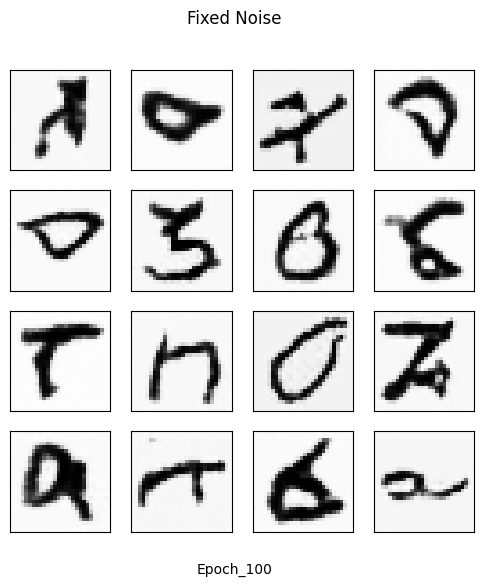

In [ ]:
generate_images(epoch, output_path, fixed_noise, num_test_samples, netG, device, use_fixed= use_fixed)


In [ ]:
# # Save gif:
# save_gif(output_path, fps, fixed_noise= use_fixed)


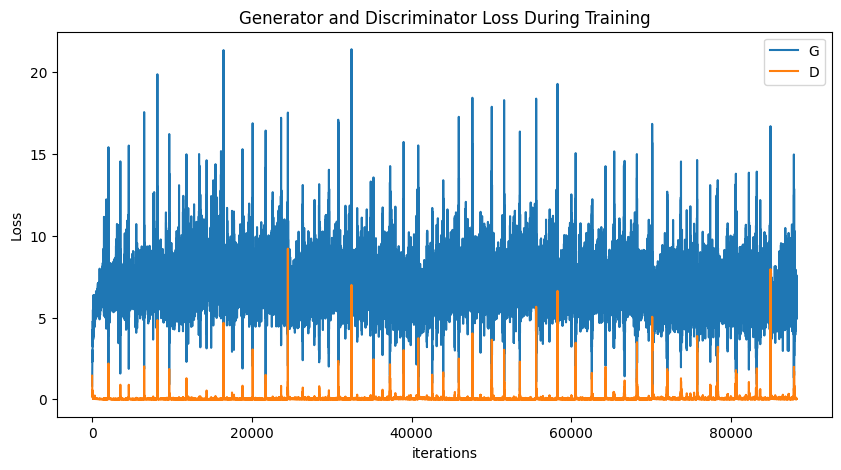

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

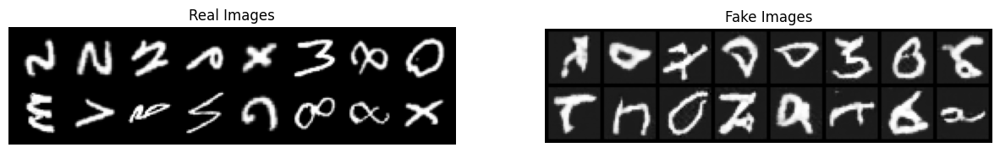

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(train_loader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:16], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

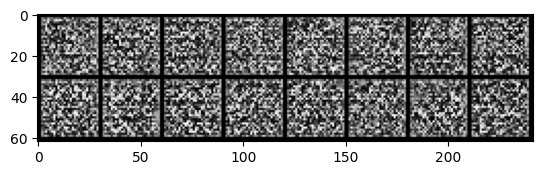

In [ ]:
im_1= plt.imshow(np.transpose(img_list[0], (1,2,0)))

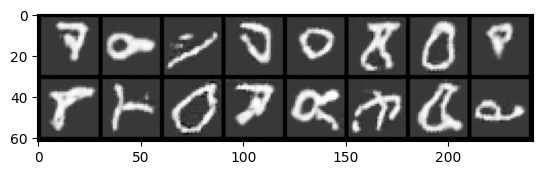

In [ ]:
im_50= plt.imshow(np.transpose(img_list[50], (1,2,0)))

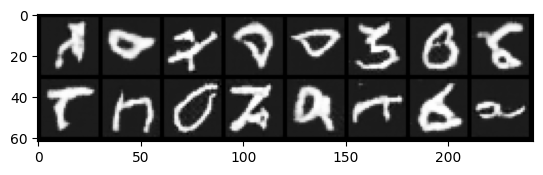

In [ ]:
im_100= plt.imshow(np.transpose(img_list[100], (1,2,0)))



---



---



---



 **QUESTION 2: STYLE GAN**



---



---



**GENERATING 10 IMAGES FROM STYLE GAN 3**

In [ ]:
!git clone https://github.com/NVlabs/stylegan3.git
!pip install ninja

Cloning into 'stylegan3'...
remote: Enumerating objects: 212, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 212 (delta 0), reused 1 (delta 0), pack-reused 207
Receiving objects: 100% (212/212), 4.16 MiB | 5.91 MiB/s, done.
Resolving deltas: 100% (101/101), done.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 146.0/146.0 kB 9.8 MB/s eta 0:00:00



Verify that StyleGAN has been cloned.

In [ ]:
!ls /content/stylegan3

avg_spectra.py	 Dockerfile	  gen_video.py	metrics      train.py
calc_metrics.py  docs		  gui_utils	README.md    visualizer.py
dataset_tool.py  environment.yml  legacy.py	torch_utils  viz
dnnlib		 gen_images.py	  LICENSE.txt	training


In [ ]:
# HIDE OUTPUT
URL = "https://api.ngc.nvidia.com/v2/models/nvidia/research/"\
      "stylegan3/versions/1/files/stylegan3-r-ffhq-1024x1024.pkl"

!python /content/stylegan3/gen_images.py \
    --network={URL} \
  --outdir=/content/results --seeds=0-9

Loading networks from "https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/stylegan3-r-ffhq-1024x1024.pkl"...
Generating image for seed 0 (0/10) ...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "filtered_lrelu_plugin"... Done.
Generating image for seed 1 (1/10) ...
Generating image for seed 2 (2/10) ...
Generating image for seed 3 (3/10) ...
Generating image for seed 4 (4/10) ...
Generating image for seed 5 (5/10) ...
Generating image for seed 6 (6/10) ...
Generating image for seed 7 (7/10) ...
Generating image for seed 8 (8/10) ...
Generating image for seed 9 (9/10) ...


We can now display the images created.

In [ ]:
!ls /content/results

seed0000.png  seed0002.png  seed0004.png  seed0006.png	seed0008.png
seed0001.png  seed0003.png  seed0005.png  seed0007.png	seed0009.png


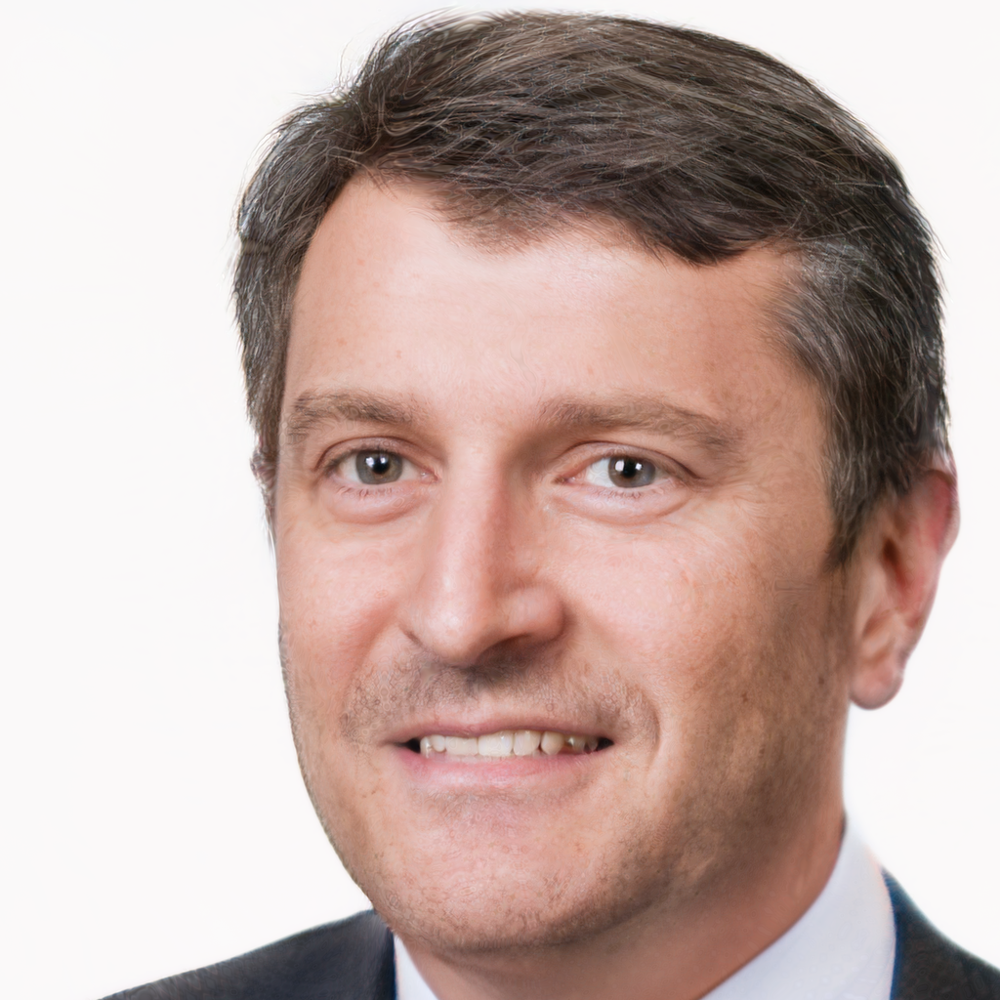

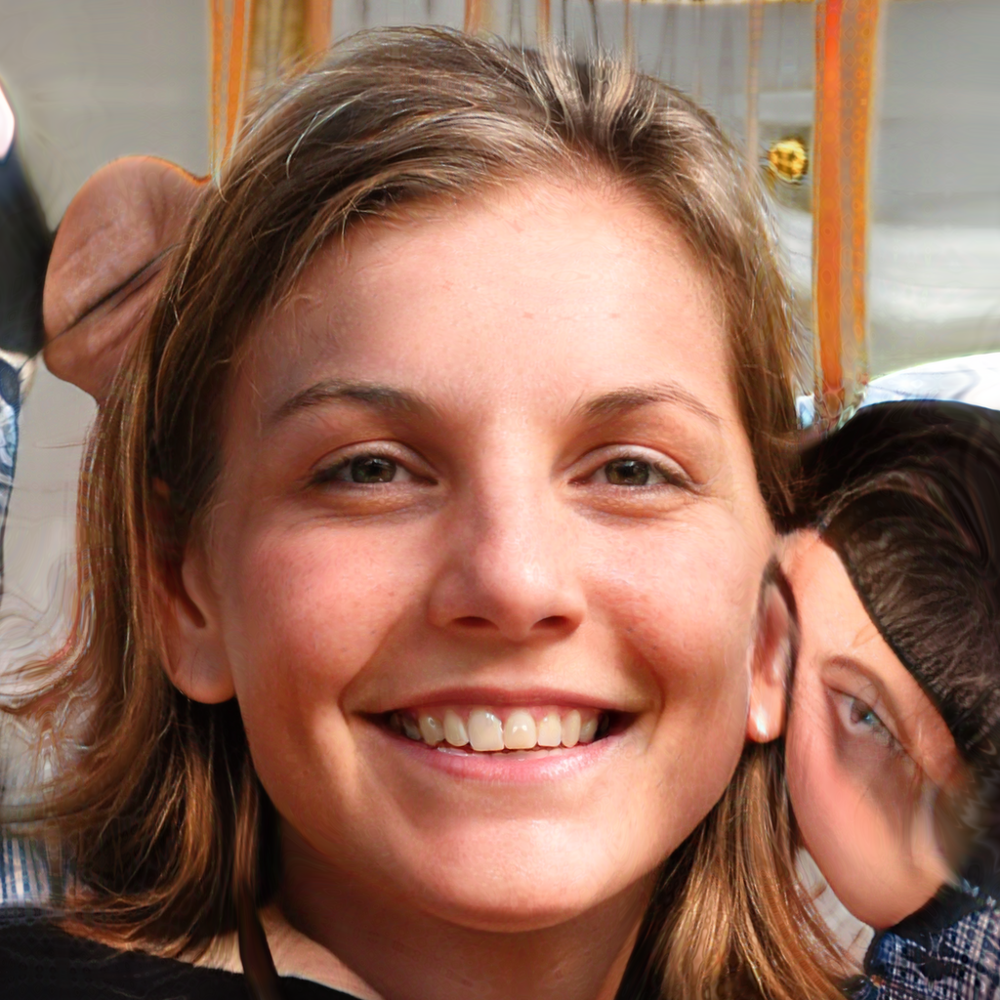

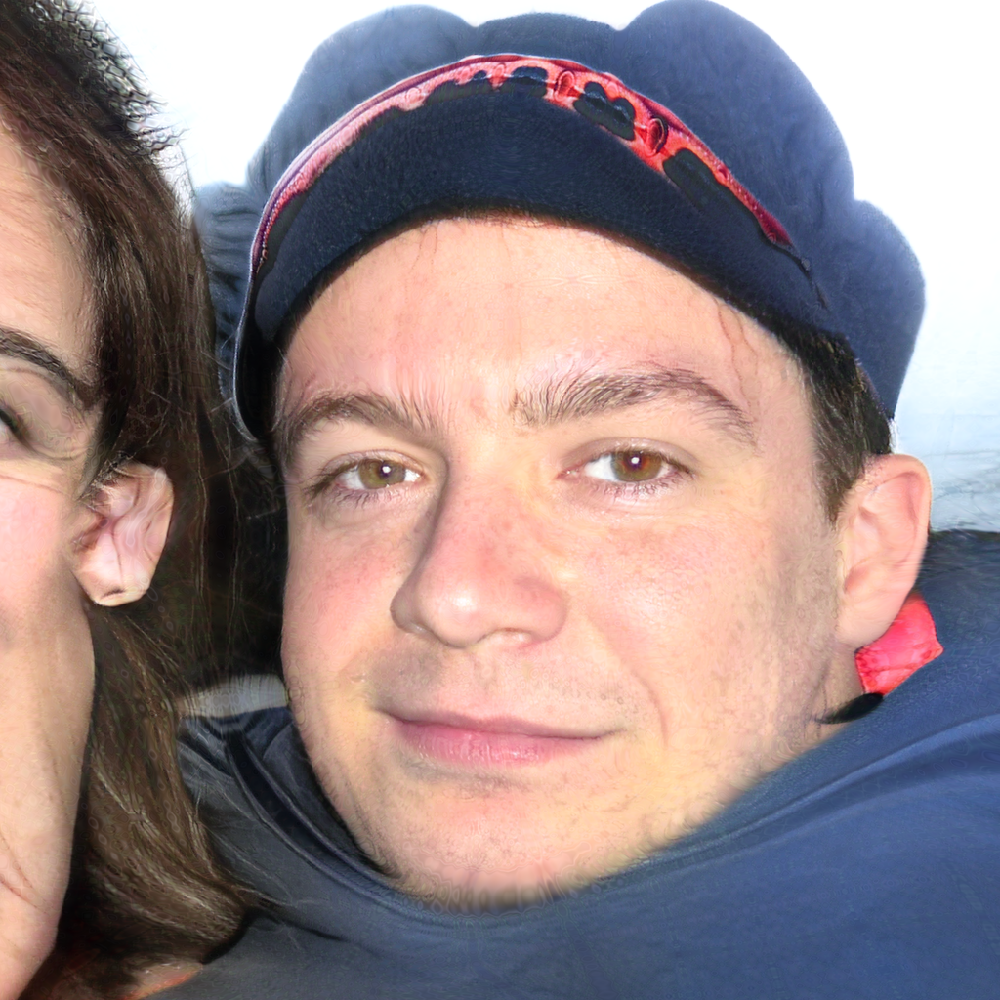

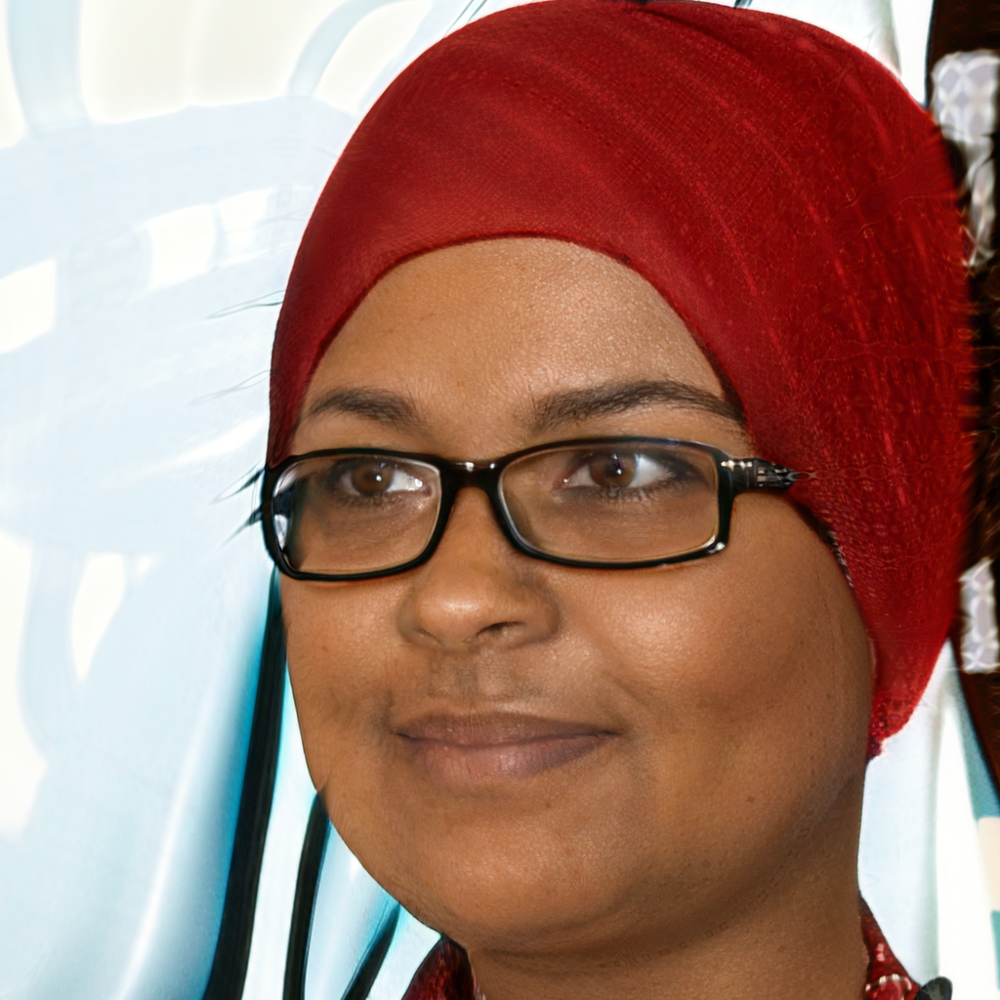

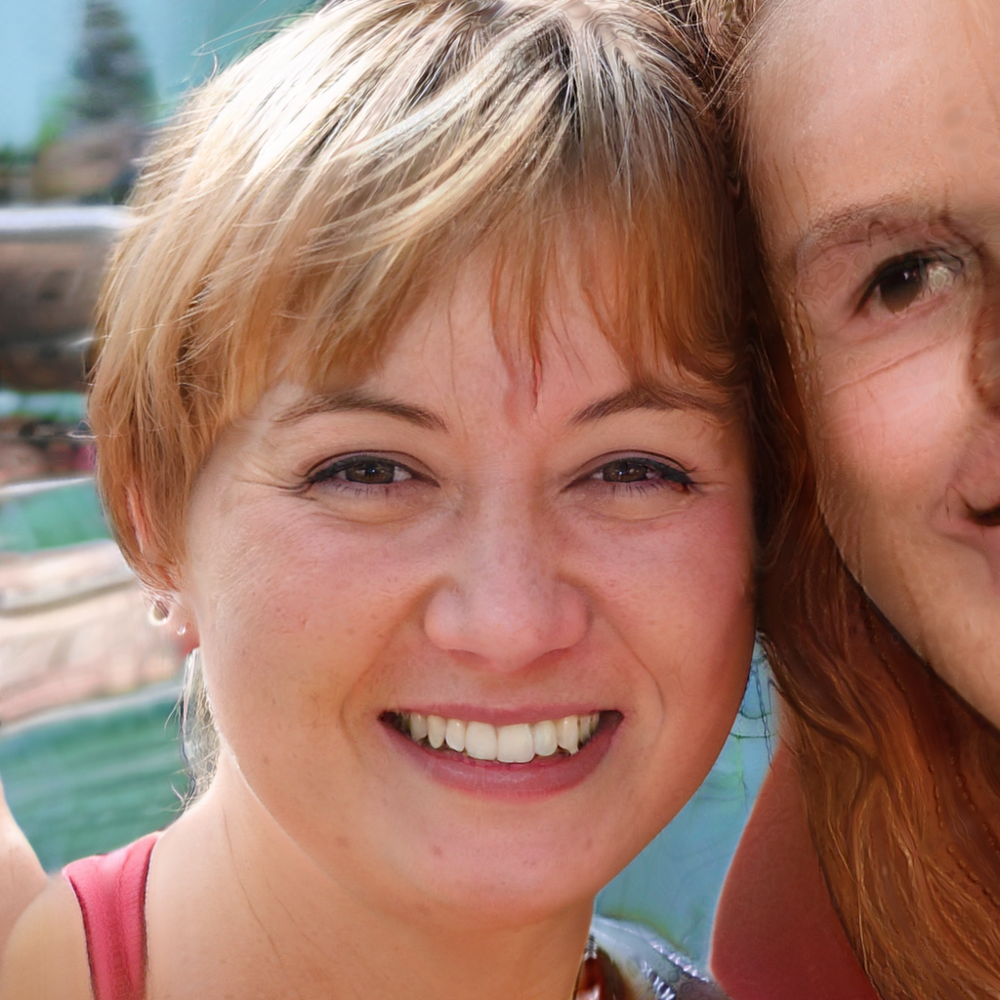

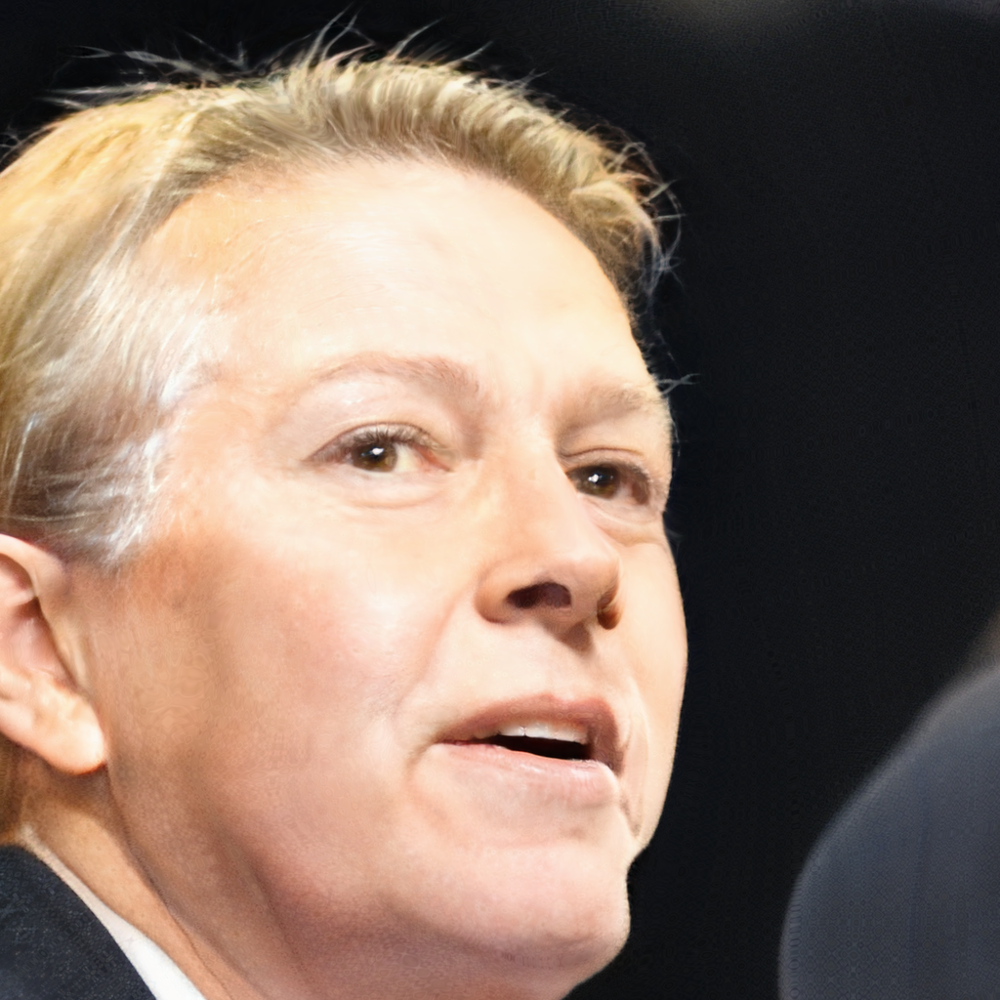

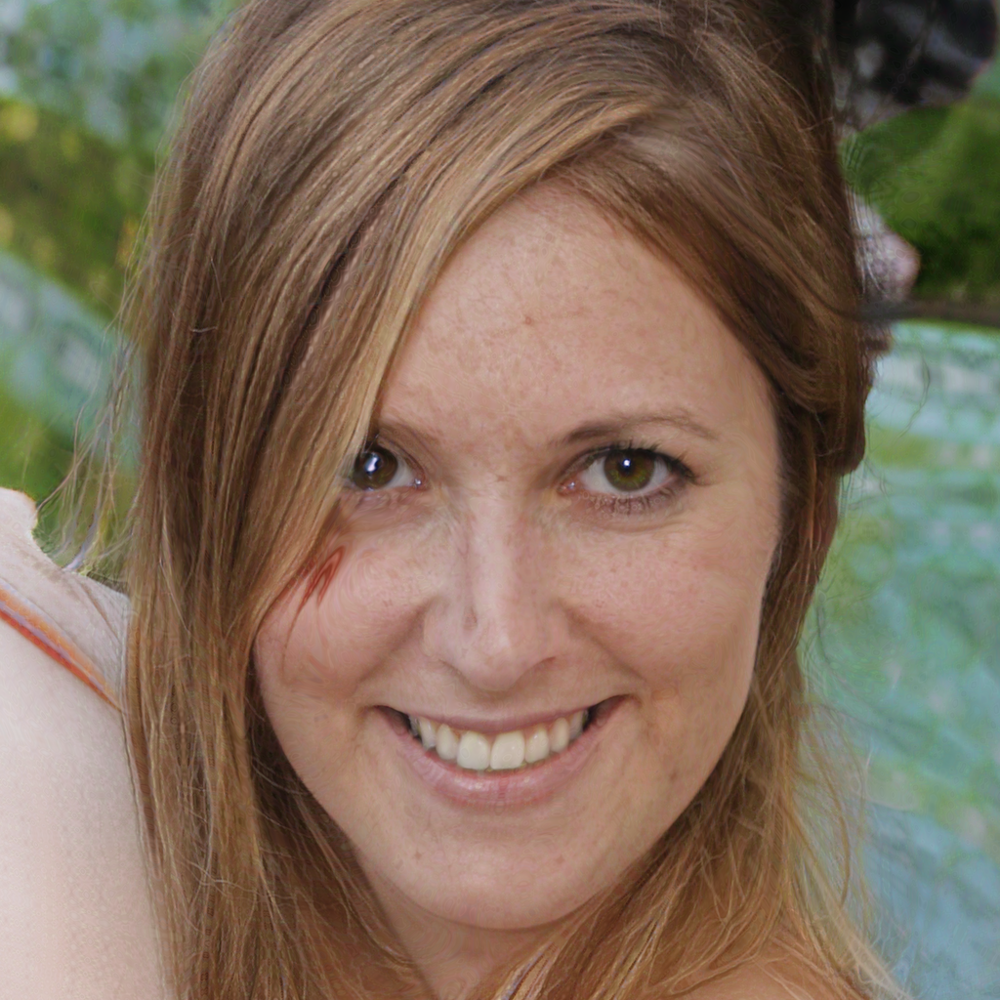

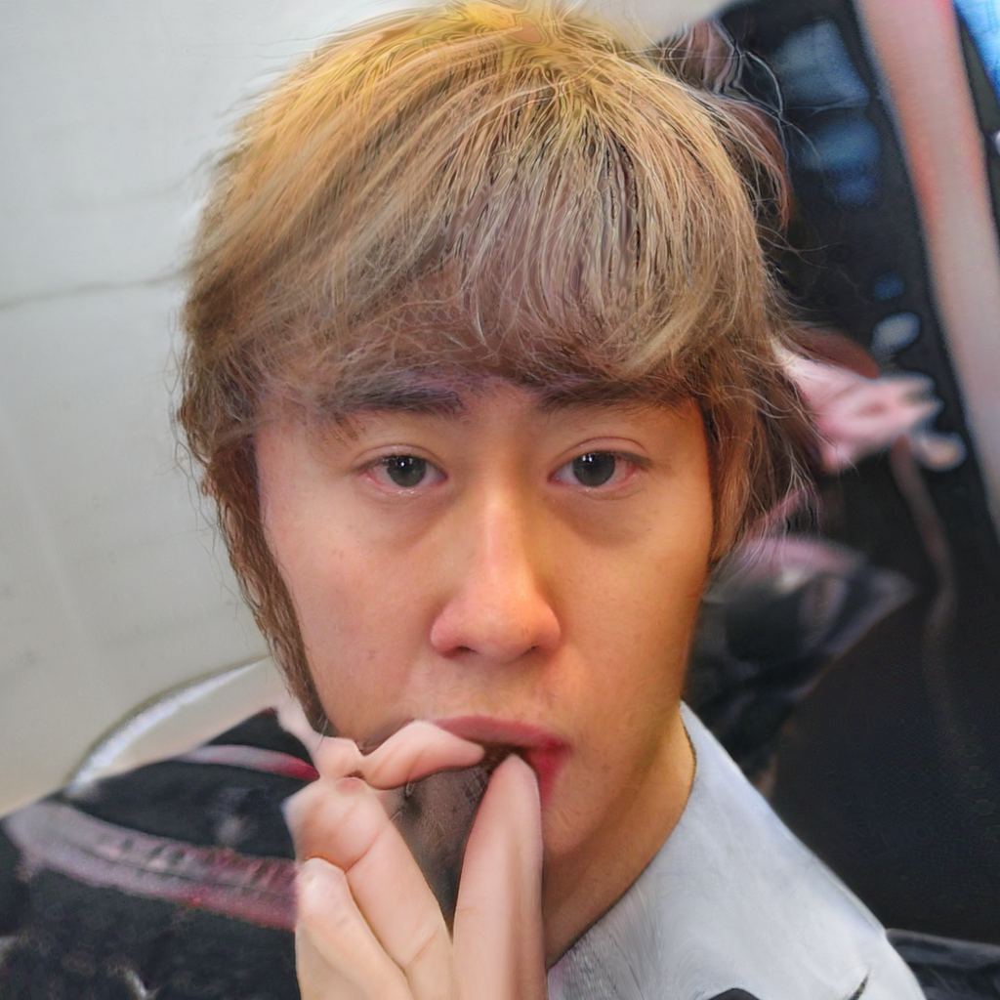

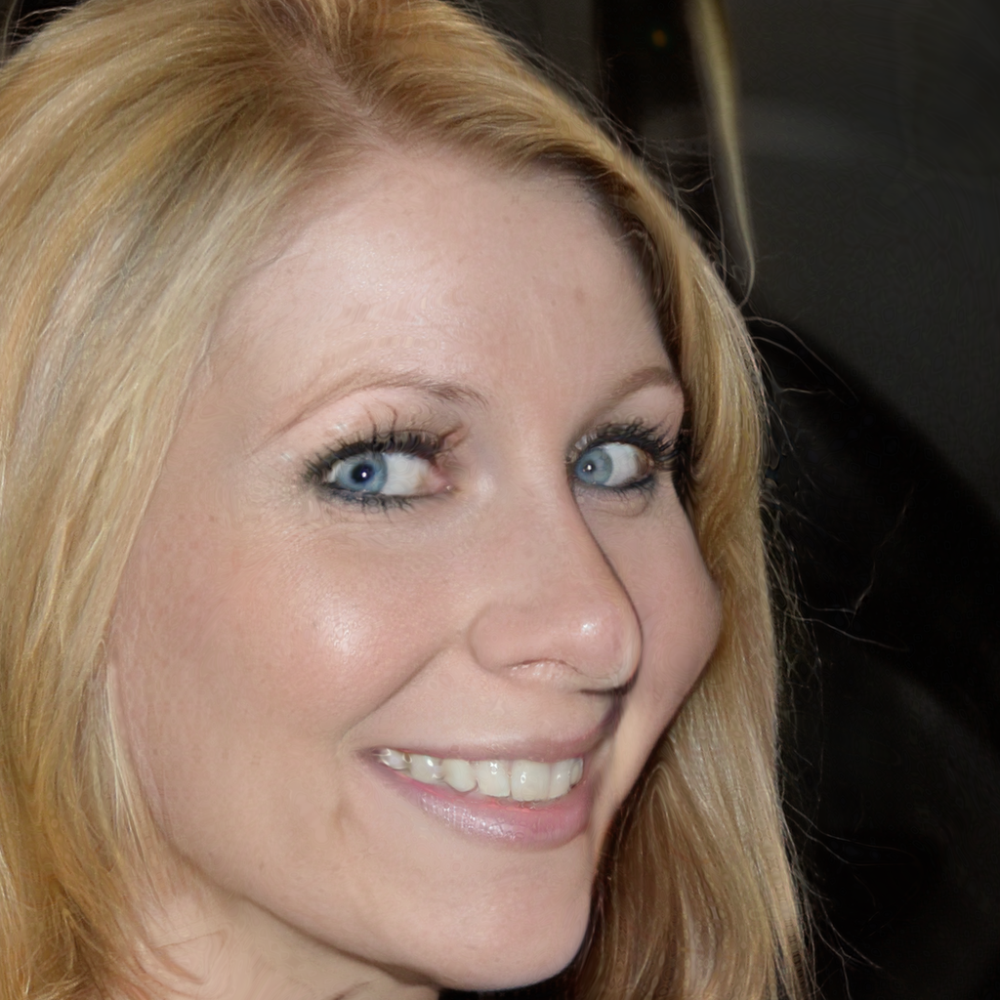

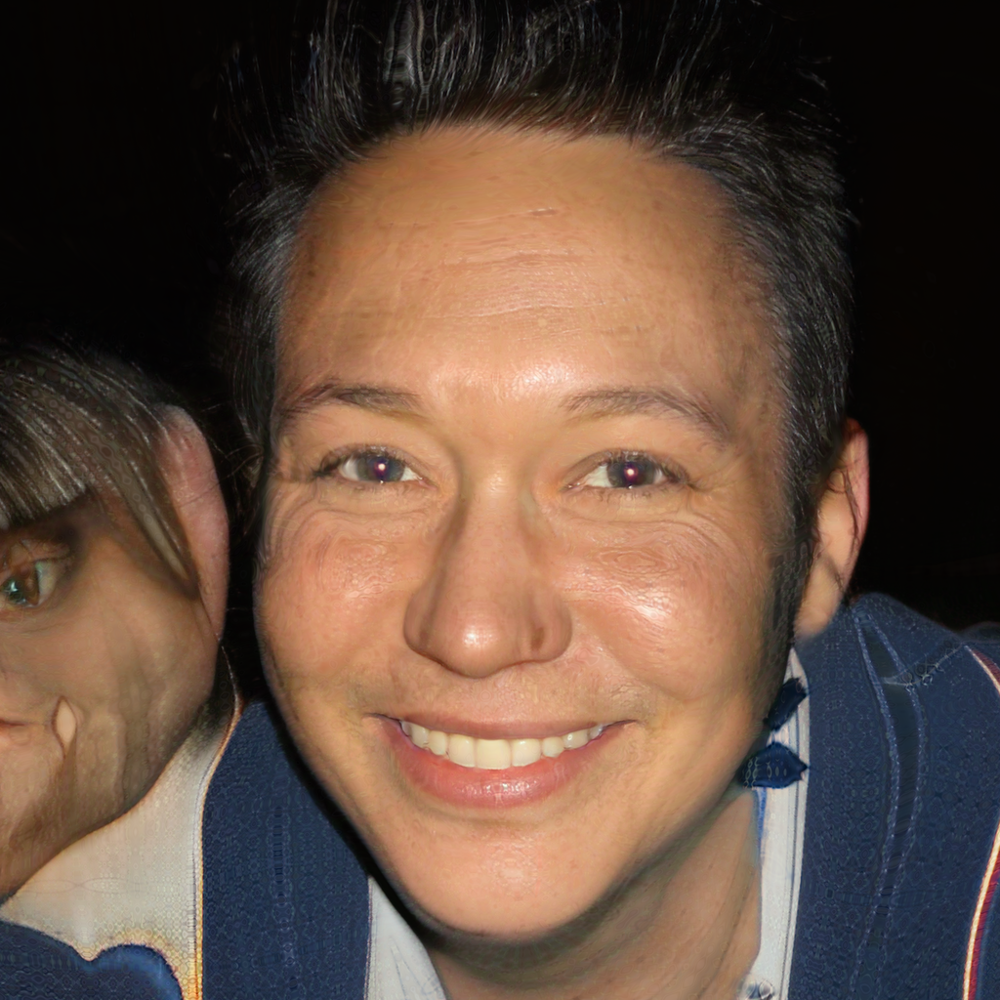

In [ ]:
import os
from PIL import Image

folder_path = "/content/results"
image_extensions = ["jpg", "jpeg", "png", "gif"] # Add any other image extensions you want to include

for filename in os.listdir(folder_path):
    extension = filename.split(".")[-1].lower()
    if extension in image_extensions:
        image_path = os.path.join(folder_path, filename)
        image = Image.open(image_path)
        image.show()



---



---



**INTERPOLATION BETWEEN 2 IMAGES**



---



---



In [ ]:
NETWORK = "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"

In [ ]:
!wget http://dlib.net/files/shape_predictor_5_face_landmarks.dat.bz2
!bzip2 -d shape_predictor_5_face_landmarks.dat.bz2

--2023-05-01 12:57:38--  http://dlib.net/files/shape_predictor_5_face_landmarks.dat.bz2
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5706710 (5.4M)
Saving to: ‘shape_predictor_5_face_landmarks.dat.bz2’

shape_predictor_5_f 100%[===================>]   5.44M  2.71MB/s    in 2.0s    

2023-05-01 12:57:40 (2.71 MB/s) - ‘shape_predictor_5_face_landmarks.dat.bz2’ saved [5706710/5706710]



In [ ]:
import sys
!git clone https://github.com/NVlabs/stylegan2-ada-pytorch.git
!pip install ninja
sys.path.insert(0, "/content/stylegan2-ada-pytorch")

Cloning into 'stylegan2-ada-pytorch'...
remote: Enumerating objects: 128, done.
remote: Total 128 (delta 0), reused 0 (delta 0), pack-reused 128
Receiving objects: 100% (128/128), 1.12 MiB | 2.49 MiB/s, done.
Resolving deltas: 100% (57/57), done.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import cv2
import numpy as np
from PIL import Image
import dlib

detector = dlib.get_frontal_face_detector()
predictor = dlib.shape_predictor('shape_predictor_5_face_landmarks.dat')

def find_eyes(img):
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  rects = detector(gray, 0)

  if len(rects) == 0:
    raise ValueError("No faces detected")
  elif len(rects) > 1:
    raise ValueError("Multiple faces detected")

  shape = predictor(gray, rects[0])
  features = []

  for i in range(0, 5):
    features.append((i, (shape.part(i).x, shape.part(i).y)))

  return (int(features[3][1][0] + features[2][1][0]) // 2, \
    int(features[3][1][1] + features[2][1][1]) // 2), \
    (int(features[1][1][0] + features[0][1][0]) // 2, \
    int(features[1][1][1] + features[0][1][1]) // 2)

def crop_stylegan(img):
  left_eye, right_eye = find_eyes(img)
  d = abs(right_eye[0] - left_eye[0])
  z = 255/d
  ar = img.shape[0]/img.shape[1]
  w = img.shape[1] * z
  img2 = cv2.resize(img, (int(w), int(w*ar)))
  bordersize = 1024
  img3 = cv2.copyMakeBorder(
      img2,
      top=bordersize,
      bottom=bordersize,
      left=bordersize,
      right=bordersize,
      borderType=cv2.BORDER_REPLICATE)

  left_eye2, right_eye2 = find_eyes(img3)

  crop1 = left_eye2[0] - 385
  crop0 = left_eye2[1] - 490
  return img3[crop0:crop0+1024,crop1:crop1+1024]

In [ ]:
def interpolate(img1, img2, video_name):

    from matplotlib import pyplot as plt
    import cv2
    import torch
    import dnnlib
    import legacy
    import PIL.Image
    import numpy as np
    import imageio
    from tqdm.notebook import tqdm
    from google.colab.patches import cv2_imshow

    image_source = cv2.imread(img1)

    image_target = cv2.imread(img2)

    cropped_source = crop_stylegan(image_source)
    cropped_target = crop_stylegan(image_target)


    cv2.imwrite("cropped_source.png", cropped_source)
    cv2.imwrite("cropped_target.png", cropped_target)

    cmd = f"python /content/stylegan2-ada-pytorch/projector.py --save-video 0 --num-steps 10 --outdir=out_source --target=cropped_source.png --network={NETWORK}"
    !{cmd}

    cmd = f"python /content/stylegan2-ada-pytorch/projector.py --save-video 0 --num-steps 10 --outdir=out_target --target=cropped_target.png --network={NETWORK}"
    !{cmd}


    STEPS = 70
    FPS = 20
    FREEZE_STEPS = 30

    lvec1 = np.load('/content/out_source/projected_w.npz')['w']
    lvec2 = np.load('/content/out_target/projected_w.npz')['w']

    network_pkl = "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"
    device = torch.device('cuda')
    with dnnlib.util.open_url(network_pkl) as fp:
        G = legacy.load_network_pkl(fp)['G_ema'].requires_grad_(False).to(device) # type: ignore

    diff = lvec2 - lvec1
    step = diff / STEPS
    current = lvec1.copy()
    target_uint8 = np.array([1024,1024,3], dtype=np.uint8)


    video = imageio.get_writer(f"/content/{video_name}.mp4", mode='I', fps=FPS, codec='libx264', bitrate='16M')

    for j in tqdm(range(STEPS)):

      z = torch.from_numpy(current).to(device)
      synth_image = G.synthesis(z, noise_mode='const')
      synth_image = (synth_image + 1) * (255/2)
      synth_image = synth_image.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()

      repeat = FREEZE_STEPS if j==0 or j==(STEPS-1) else 1

      for i in range(repeat):
        video.append_data(synth_image)
      current = current + step


    video.close()


    # Open the video file
    video = cv2.VideoCapture(f"/content/{video_name}.mp4")

    # Initialize variables
    fps = video.get(cv2.CAP_PROP_FPS)
    frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
    frames_to_extract = [int(fps*i) for i in range(1, 7)]
    frames = []

    # Loop through each frame and extract the ones we want
    for i in range(frame_count):
        ret, frame = video.read()
        if i in frames_to_extract:
            frames.append(frame)

    # Concatenate the frames horizontally
    combined_image = np.concatenate(frames, axis=1)

    # Display the combined image
    return cv2_imshow(combined_image)


Loading networks from "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"...
Computing W midpoint and stddev using 10000 samples...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1501: UserWarning: operator() profile_node %106 : int = prim::profile_ivalue(%104)
 does not have profile information (Triggered internally at ../third_party/nvfuser/csrc/graph_fuser.cpp:104.)
  return forward_call(*args, **kwargs)
step    1/10: dist 0.71 loss 24567.38
step    2/10: dist 0.70 loss 27640.67
step    3/10: dist 0.58 loss 22796.79
step    4/10: dist 0.51 loss 7793.32
step    5/10: dist 0.50 loss 4680.49
step    6/10: dist 0.47 loss 8775.49
step    7/10: dist 0.46 loss 10214.43
step    8/10: dist 0.45 loss 8381.30
step    9/10: dist 0.44 loss 6318.49
step   10/10: dist 0.44 loss 5704.20
Elapsed: 7.2 s
Loading networks from "https://nvlabs-fi-cdn.nvi

  0%|          | 0/70 [00:00<?, ?it/s]

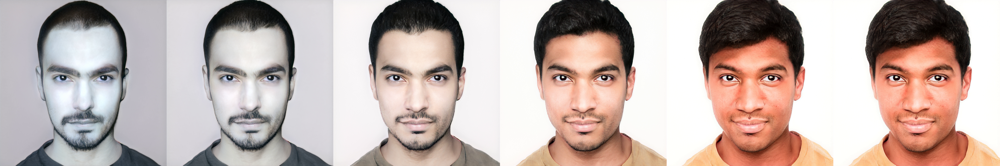

In [ ]:
me= "/content/me.jpg"
akash= "/content/akash.jpg"

interpolate(me, akash, video_name= 'video1')

Loading networks from "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"...
Computing W midpoint and stddev using 10000 samples...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1501: UserWarning: operator() profile_node %106 : int = prim::profile_ivalue(%104)
 does not have profile information (Triggered internally at ../third_party/nvfuser/csrc/graph_fuser.cpp:104.)
  return forward_call(*args, **kwargs)
step    1/10: dist 0.71 loss 24567.38
step    2/10: dist 0.70 loss 27640.67
step    3/10: dist 0.58 loss 22796.79
step    4/10: dist 0.51 loss 7793.32
step    5/10: dist 0.49 loss 4680.48
step    6/10: dist 0.46 loss 8775.47
step    7/10: dist 0.44 loss 10214.41
step    8/10: dist 0.43 loss 8381.27
step    9/10: dist 0.42 loss 6318.47
step   10/10: dist 0.41 loss 5704.18
Elapsed: 7.3 s
Loading networks from "https://nvlabs-fi-cdn.nvi

  0%|          | 0/70 [00:00<?, ?it/s]

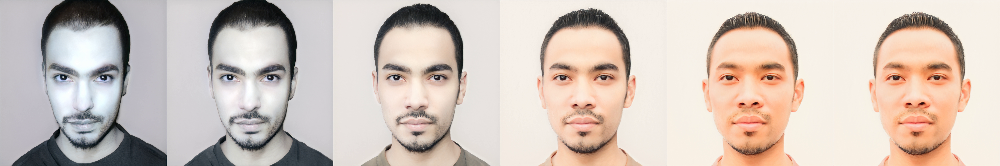

In [ ]:
me= "/content/me.jpg"
sanjeev= "/content/sanjeev.jpg"

interpolate(me, sanjeev, video_name= 'video2')

Loading networks from "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"...
Computing W midpoint and stddev using 10000 samples...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1501: UserWarning: operator() profile_node %106 : int = prim::profile_ivalue(%104)
 does not have profile information (Triggered internally at ../third_party/nvfuser/csrc/graph_fuser.cpp:104.)
  return forward_call(*args, **kwargs)
step    1/10: dist 0.71 loss 24567.38
step    2/10: dist 0.70 loss 27640.67
step    3/10: dist 0.58 loss 22796.79
step    4/10: dist 0.51 loss 7793.32
step    5/10: dist 0.49 loss 4680.48
step    6/10: dist 0.46 loss 8775.47
step    7/10: dist 0.44 loss 10214.41
step    8/10: dist 0.42 loss 8381.27
step    9/10: dist 0.42 loss 6318.47
step   10/10: dist 0.42 loss 5704.18
Elapsed: 6.8 s
Loading networks from "https://nvlabs-fi-cdn.nvi

  0%|          | 0/70 [00:00<?, ?it/s]

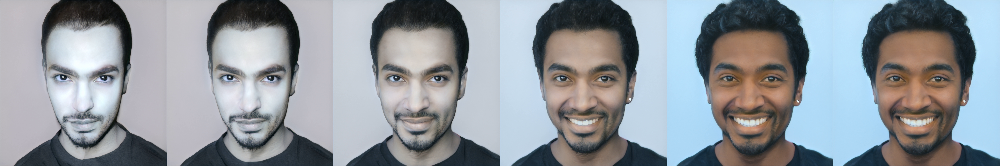

In [ ]:
me= "/content/me.jpg"
tanmay= "/content/tanmay.jpg"

interpolate(me, tanmay, video_name= 'video3')

Loading networks from "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"...
Computing W midpoint and stddev using 10000 samples...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1501: UserWarning: operator() profile_node %105 : int = prim::profile_ivalue(%103)
 does not have profile information (Triggered internally at ../third_party/nvfuser/csrc/graph_fuser.cpp:104.)
  return forward_call(*args, **kwargs)
step    1/10: dist 0.71 loss 24567.38
step    2/10: dist 0.70 loss 27640.67
step    3/10: dist 0.58 loss 22796.79
step    4/10: dist 0.51 loss 7793.32
step    5/10: dist 0.49 loss 4680.48
step    6/10: dist 0.45 loss 8775.47
step    7/10: dist 0.43 loss 10214.41
step    8/10: dist 0.43 loss 8381.27
step    9/10: dist 0.42 loss 6318.46
step   10/10: dist 0.42 loss 5704.18
Elapsed: 8.1 s
Loading networks from "https://nvlabs-fi-cdn.nvi

  0%|          | 0/70 [00:00<?, ?it/s]

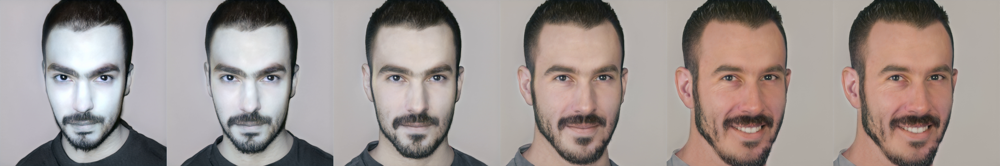

In [ ]:
me= "/content/me.jpg"
alok= "/content/alok.jpg"

interpolate(me, alok, video_name= 'video4')

Loading networks from "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"...
Computing W midpoint and stddev using 10000 samples...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1501: UserWarning: operator() profile_node %106 : int = prim::profile_ivalue(%104)
 does not have profile information (Triggered internally at ../third_party/nvfuser/csrc/graph_fuser.cpp:104.)
  return forward_call(*args, **kwargs)
step    1/10: dist 0.71 loss 24567.38
step    2/10: dist 0.70 loss 27640.67
step    3/10: dist 0.58 loss 22796.79
step    4/10: dist 0.51 loss 7793.32
step    5/10: dist 0.49 loss 4680.48
step    6/10: dist 0.46 loss 8775.48
step    7/10: dist 0.45 loss 10214.43
step    8/10: dist 0.44 loss 8381.29
step    9/10: dist 0.44 loss 6318.48
step   10/10: dist 0.43 loss 5704.19
Elapsed: 7.6 s
Loading networks from "https://nvlabs-fi-cdn.nvi

  0%|          | 0/70 [00:00<?, ?it/s]

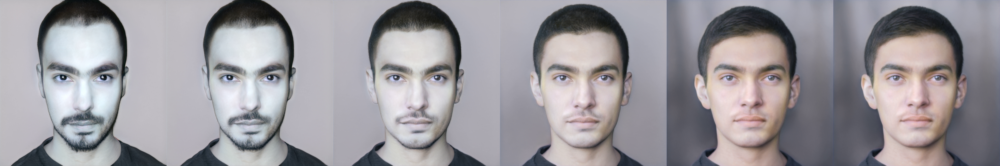

In [ ]:
me= "/content/me.jpg"
girish= "/content/girish.jpg"

interpolate(me, girish, video_name= 'video5')